In [1]:
from wordcloud import WordCloud
import pandas as pd
import matplotlib.pyplot as plt
from random import randint
import os
from PIL import Image
import numpy as np

In [2]:
tags = pd.read_csv("data/Tags.csv", dtype={'Tag': str})
tag_count = pd.DataFrame(tags["Tag"].value_counts()).reset_index().rename(columns={'index':'tag', 'Tag':'count'})
tag_count.head()

,tag,count
0,javascript,124155
1,java,115212
2,c#,101186
3,php,98808
4,android,90659


In [92]:
tag_count.__len__()

37034

In [10]:
def orange_color_function(word, font_size, position, orientation, random_state=None, **kwargs):
    return f"hsl(26.6, {randint(50, 100)}%, {randint(25, 75)}%)"


def show_wordcloud_from_frequencies(frequencies, filename, *, mode='RGBA', mask=None, background_color="white", height=None, width=None, show_image=True):
    if mask is None:
        wordcloud = WordCloud(mode=mode, max_words=None, width=width, height=height, background_color=background_color)\
        .generate_from_frequencies(frequencies).recolor(color_func=orange_color_function, random_state=3)
    if mask is not None:
        wordcloud = WordCloud(mode=mode, max_words=None, background_color=background_color, mask=mask)\
        .generate_from_frequencies(frequencies).recolor(color_func=orange_color_function, random_state=3)
    if show_image:
        plt.figure(figsize=(192, 108))
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.show()
    if not os.path.exists("wordclouds/"):
        os.makedirs("wordclouds/")
    wordcloud.to_file(f"./wordclouds/{filename}.png")

In [114]:
top_100_tags = {tag: count for tag, count in zip(tag_count[:100]["tag"], tag_count[:100]["count"])}
show_wordcloud_from_frequencies(top_100_tags, "top_100_tags_1920x1080", width=1920, height=1080)

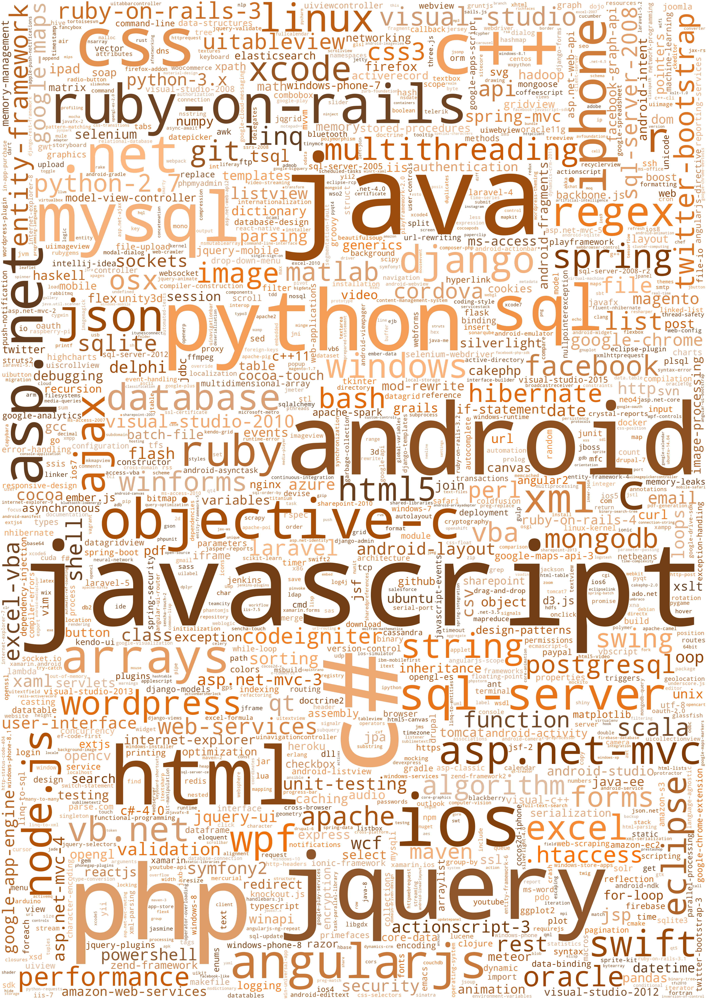

In [120]:
just_1337_tags = {tag: count for tag, count in zip(tag_count["tag"][:1337], tag_count["count"][:1337])}
show_wordcloud_from_frequencies(just_1337_tags, "just_1337_tags_4961x7016", width=4961, height=7016)

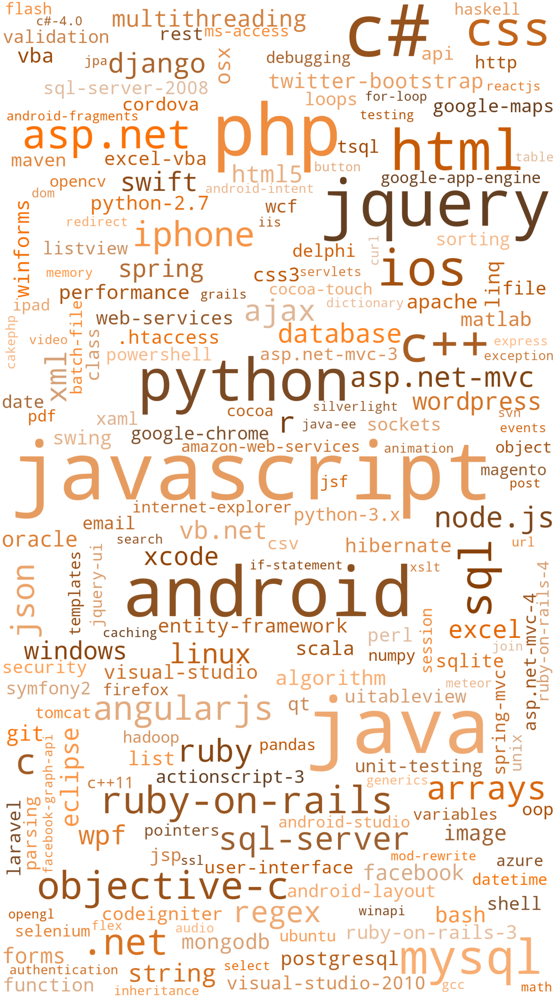

In [11]:
just_200_tags = {tag: count for tag, count in zip(tag_count["tag"][:200], tag_count["count"][:200])}
show_wordcloud_from_frequencies(
    just_200_tags,
    "stack_overflow_logo_1337x2337",
    mask=np.array(Image.open("./wordclouds/stack_overflow_logo.png")),
    background_color="white",
)